In [35]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from dateutil.relativedelta import relativedelta
from datetime import datetime
import warnings
warnings.filterwarnings('ignore')

In [55]:
df = pd.read_csv('https://srhdpeuwpubsa.blob.core.windows.net/whdh/COVID/WHO-COVID-19-global-daily-data.csv')
df.head()

,Date_reported,Country_code,Country,WHO_region,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths
0,2020-01-04,AI,Anguilla,AMR,NaN,0,NaN,0
1,2020-01-04,AZ,Azerbaijan,EUR,NaN,0,NaN,0
2,2020-01-04,BD,Bangladesh,SEAR,0.00,0,0.00,0
3,2020-01-04,BB,Barbados,AMR,NaN,0,NaN,0
4,2020-01-04,BR,Brazil,AMR,NaN,0,NaN,0


In [57]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 489360 entries, 0 to 489359
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Date_reported      489360 non-null  object 
 1   Country_code       487321 non-null  object 
 2   Country            489360 non-null  object 
 3   WHO_region         489360 non-null  object 
 4   New_cases          210338 non-null  float64
 5   Cumulative_cases   489360 non-null  int64  
 6   New_deaths         153975 non-null  float64
 7   Cumulative_deaths  489360 non-null  int64  
dtypes: float64(2), int64(2), object(4)
memory usage: 29.9+ MB


In [58]:
pd.options.display.float_format = '{:,.2f}'.format
df.describe()

,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths
count,"210,338.00","489,360.00","153,975.00","489,360.00"
mean,"3,701.06","2,044,598.34",46.11,"21,675.56"
std,"48,564.63","8,522,920.66",242.36,"86,811.20"
min,"-65,079.00",0.00,"-3,520.00",0.00
25%,3.00,"6,602.00",0.00,40.00
50%,61.00,"59,502.00",2.00,690.00
75%,677.00,"660,937.00",15.00,"7,942.00"
max,"6,966,046.00","103,436,829.00","44,047.00","1,226,130.00"


In [59]:
df.duplicated().sum()

np.int64(0)

In [60]:
df.isnull().sum()

,0
Date_reported,0
Country_code,2039
Country,0
WHO_region,0
New_cases,279022
Cumulative_cases,0
New_deaths,335385
Cumulative_deaths,0


In [61]:
round(df.isna().mean() * 100 ,2)

,0
Date_reported,0.00
Country_code,0.42
Country,0.00
WHO_region,0.00
New_cases,57.02
Cumulative_cases,0.00
New_deaths,68.54
Cumulative_deaths,0.00


In [62]:
df.columns = df.columns.str.lower()

In [63]:
df.sample()

,date_reported,country_code,country,who_region,new_cases,cumulative_cases,new_deaths,cumulative_deaths
16759,2020-03-13,BI,Burundi,AFR,NaN,0,NaN,0


In [44]:
#df.drop('country_code',axis=1,inplace=True)

In [64]:
df.fillna(0,inplace=True)

In [65]:
round(df.isna().mean() * 100 ,2)

,0
date_reported,0.00
country_code,0.00
country,0.00
who_region,0.00
new_cases,0.00
cumulative_cases,0.00
new_deaths,0.00
cumulative_deaths,0.00


In [66]:
df['date_reported'] = pd.to_datetime(df['date_reported'], format='%Y-%m-%d')

In [67]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 489360 entries, 0 to 489359
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   date_reported      489360 non-null  datetime64[ns]
 1   country_code       489360 non-null  object        
 2   country            489360 non-null  object        
 3   who_region         489360 non-null  object        
 4   new_cases          489360 non-null  float64       
 5   cumulative_cases   489360 non-null  int64         
 6   new_deaths         489360 non-null  float64       
 7   cumulative_deaths  489360 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(2), object(3)
memory usage: 29.9+ MB


In [68]:
relativedelta(df.date_reported.max(), df.date_reported.min())

relativedelta(years=+5, months=+6, days=+30)

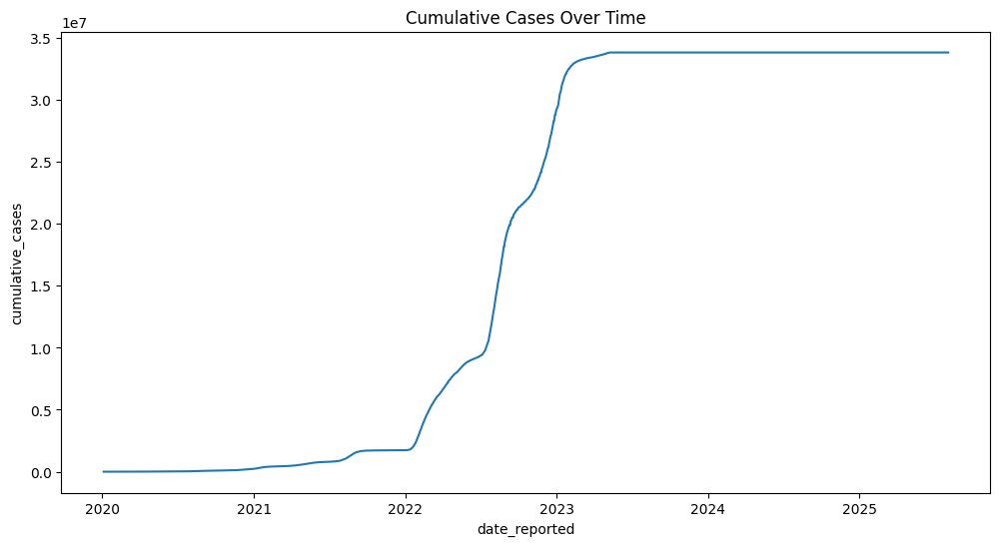

In [69]:
plt.figure(figsize=(12,6))
sns.lineplot(x='date_reported',y='cumulative_cases',data=df[df.country == "Japan"])
plt.title('Cumulative Cases Over Time')
plt.show()

In [51]:
px.line(df[df.country == "Japan"], x='date_reported', y='cumulative_cases', title='Cumulative Cases Over Time')

In [72]:
df['year'] = df.date_reported.dt.year
df['month'] = df.date_reported.dt.month

In [78]:
# For the next visualization we need the country code to be iso3 for example Egypt -> EGY not EG

#!pip install pycountry
import pycountry

def get_iso3(country_name):
    try:
        return pycountry.countries.lookup(country_name).alpha_3
    except:
        return None

df['country_code'] = df['country'].apply(get_iso3)


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.3/6.3 MB 42.5 MB/s eta 0:00:00


In [81]:
 px.choropleth(df, locations="country_code", animation_frame="year",  hover_name="country", color="cumulative_cases")

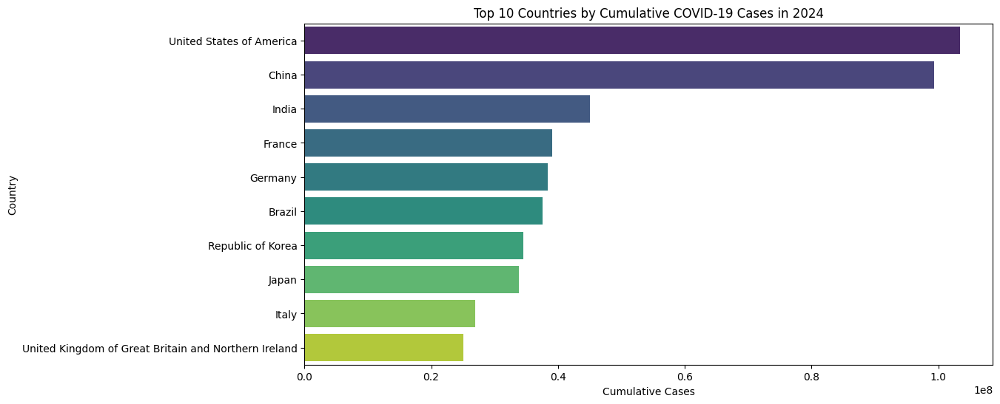

In [99]:
df_2024 = df[df['year'] == 2024]
df_top10 = (
    df_2024.groupby('country')['cumulative_cases'].max().sort_values(ascending=False).head(10))
plt.figure(figsize=(12,6))
sns.barplot(
    y=df_top10.index,
    x=df_top10.values,
    palette="viridis"
)
plt.title("Top 10 Countries by Cumulative COVID-19 Cases in 2024")
plt.xlabel("Cumulative Cases")
plt.ylabel("Country")
plt.show()

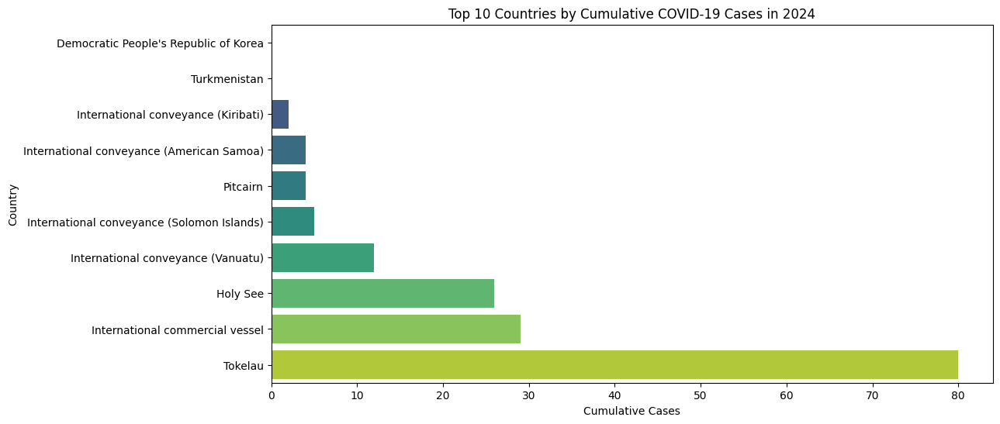

In [103]:
df_2024 = df[df['year'] == 2024]
df_least10 = (
    df_2024.groupby('country')['cumulative_cases'].max().sort_values(ascending=True).head(10))
plt.figure(figsize=(12,6))
sns.barplot(
    y=df_least10.index,
    x=df_least10.values,
    palette="viridis"
)
plt.title("Top 10 Countries by Cumulative COVID-19 Cases in 2024")
plt.xlabel("Cumulative Cases")
plt.ylabel("Country")
plt.show()

<Axes: xlabel='month', ylabel='new_cases'>

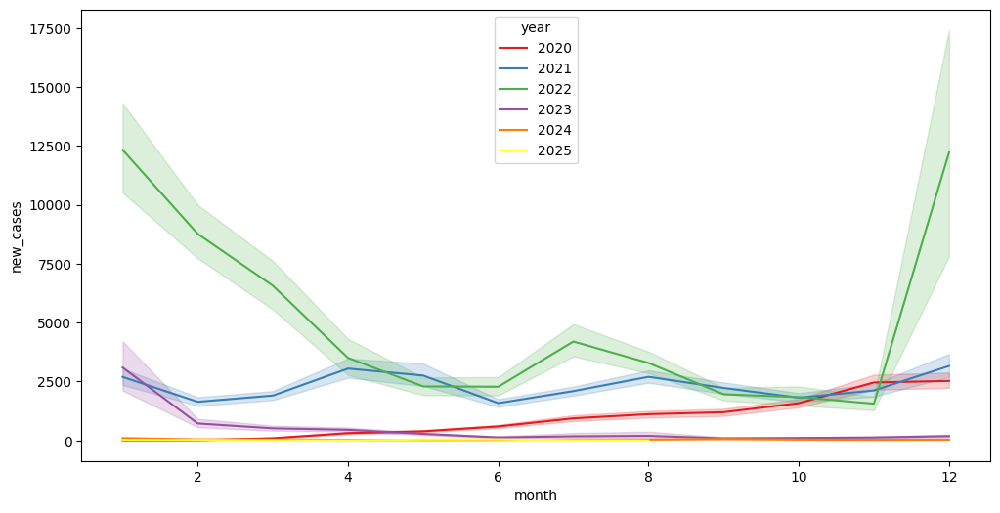

In [104]:
plt.figure(figsize=(12,6))
sns.lineplot(x='month', y='new_cases', hue ='year', data=df, palette='Set1')

In [106]:
df['month_year'] = df.date_reported.dt.to_period('M').astype(str)

In [108]:
px.histogram(df, x='month_year', y='cumulative_cases', color='year', title='New Cases Over Time')

In [139]:
def cumulative_cases_country(df,country,Xaxis):
    df_country = df[df['country']==country]
    fig = px.histogram(df_country, x=Xaxis, y='cumulative_cases', color='year', title=f'cumulative Cases Over Time in {country}')
    fig.show()

In [138]:
def cumulative_deaths_country(df,country,Xaxis):
    df_country = df[df['country']==country]
    fig = px.histogram(df_country, x=Xaxis, y='cumulative_deaths', color='year', title=f'cumulative deaths Over Time in {country}')
    fig.show()

In [140]:
cumulative_cases_country(df,'Japan','month_year')

In [141]:
px.line(df[df.country == "Japan"], x='date_reported', y='cumulative_deaths', title='Cumulative deaths Over Time')

In [135]:
df[df['new_cases'] < 0]

,date_reported,country_code,country,who_region,new_cases,cumulative_cases,new_deaths,cumulative_deaths,year,month,month_year,season
255,2020-01-05,FIN,Finland,EUR,-1.00,0,0.00,0,2020,1,2020-01,Winter
3352,2020-01-17,THA,Thailand,SEAR,-3.00,2,0.00,0,2020,1,2020-01,Winter
4791,2020-01-23,THA,Thailand,SEAR,-3.00,4,0.00,0,2020,1,2020-01,Winter
5313,2020-01-26,THA,Thailand,SEAR,-3.00,5,0.00,0,2020,1,2020-01,Winter
5789,2020-01-28,LKA,Sri Lanka,SEAR,-4.00,1,0.00,0,2020,1,2020-01,Winter
7174,2020-02-02,IND,India,SEAR,-3.00,2,0.00,0,2020,2,2020-02,Winter
8165,2020-02-07,CAN,Canada,AMR,-4.00,5,0.00,0,2020,2,2020-02,Winter
13935,2020-03-02,IND,India,SEAR,-2.00,5,0.00,0,2020,3,2020-03,Spring
15475,2020-03-08,MDV,Maldives,SEAR,-4.00,2,0.00,0,2020,3,2020-03,Spring
15735,2020-03-09,IDN,Indonesia,WPR,-4.00,6,0.00,0,2020,3,2020-03,Spring


In [121]:
season_map = {
    12: "Winter", 1: "Winter", 2: "Winter",
    3: "Spring", 4: "Spring", 5: "Spring",
    6: "Summer", 7: "Summer", 8: "Summer",
    9: "Autumn", 10: "Autumn", 11: "Autumn"
}

df['season'] = df['month'].map(season_map)


In [143]:
cumulative_deaths_country(df,'Japan','season')

In [142]:
cumulative_cases_country(df,'Japan','season')

In [144]:
df['cured']=df['cumulative_cases']-df['cumulative_deaths']

In [145]:
px.histogram(df, x=df['month_year'], y='cured', color='year')

In [158]:
df_season = (df.groupby(['who_region','season'])[['new_cases','new_deaths']].sum().reset_index())
fig1 = px.bar(df_season, x="season", y="new_cases", color="who_region",title="Total New Cases per Season by Region", barmode="group")
fig1.show()


In [159]:
fig2 = px.bar(df_season, x="season", y="new_deaths", color="who_region",title="Total Deaths per Season by Region", barmode="group")
fig2.show()

# 📊 COVID-19 Insights (2024)

## Overall Trends
- Cases and deaths keep increasing over time, with peaks in some countries like Japan.
- Some negative `new_cases` or `new_deaths` values are due to data corrections.

## Top Countries
- A few countries (USA, India, Brazil) have the most cases.
- Small countries or islands report the lowest numbers.

## Geography & Seasons
- Most cases are in Americas, Europe, and parts of Asia.
- Winter and Spring have higher cases and deaths than Summer and Autumn.

## Estimated Recoveries
- Roughly calculated as cumulative cases minus deaths.
- Recoveries are increasing, but not official data.
